# Introduction and business problem

Brooklyn is one of the most diverse places in New York. Here live over 30% of NY population. However, when it comes to vegetarian food, not many places offer good deals. Vegetarianism is more welcome among young population. In this project I’ll come up with some possible location options for the venue. 


**The problem to solve**:

*Open a vegetarian restaurant of the mid-range price category in Brooklyn*. In specific, I decided to take a baseline location point the NYC College of Technology. The place is close to subway stations (as will be presented below), and has not got many dining venues so far. Therefore, the *stakeholders are mostly young people preferring vegetarian food and local employees in vicinity*. 

# Data

In the framework of this project, I’ll be using several data sources, including:

-	New York neighborhood data as per NY neighborhood data
-	NYC real estate sales data (https://geo.nyu.edu/catalog/nyu-2451-34678)
-	Foursquare api service (https://api.foursquare.com/)
-	NY subway stations data (https://geo.nyu.edu/catalog/nyu-2451-34503)
-	NY universities locations (https://geo.nyu.edu/catalog/nyu-2451-34491)

These will be used to build the neighborhood profile in vicinity and better identify if the area worth starting a business at. For instance, **NYC real estate data** will give the first insights on the price range to buy a place if needed, as well as will give some insights on the solvency of the local population. While **foursquare data** will help build the profile of the restaurants in vicinity and identify some potential competitors. **University locations** will help determine if the starting point location (to be discussed in the main report methodology section) presents the point of university agglomeration. **Subway stations** will be used to illustarte good commute options.

From the sources above, with exception of foursqaure, was downloaded as shapefiles and, since not everywhere JSON option was working, lateron converted to csv using *mygeodata* service: https://mygeodata.cloud/converter/shp-to-csv




# Methodology

The purpose of this project is to identify the possible locations for a vegetarian restaurant in Brooklyn, NYC. The project presents an active use of spatial data from NYU Spatial data repository. 

The initial prespotion for research is *mid-range real estate pricings bring mid-range restaurants category*. This assumption was tested in the course of research. At the first stage, the geodata for NY real estate will be taken and segmented (using k-means clustering) to map the distribution of building types sold in 2016. The data is to some extent outdated, yet for the purposes of this project, given no major price shifts in the previous years, the data will show the structural distribution of the sales objects. 

Once done, the clusters will be mapped using the folio library.

Then, we'll use the foursquare data to get the list and details of some venues in vicinity of 2 km. This will allow us to have a more comoprehensive look and build the places profile based on their price tier, location, tips, likes, rating and other similar charachteristics. Once done, the second clastrization will be made, this time of the venues in question. This step will help better locate the competitors. The data will be illustarted visually respecitvely. 

On the third stage I'll examine if any other educational instituions are in vicinity and how good the commute is. Once that all is put together, some street names for possible restaurant openning will be presented. 

The starting point for the location analysis is NYC College of Technology. This place is taken with the view to reaching yough people and employees who work nearby, thus covering the target audience. 

In [1]:
#import necessary libraries 
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import numpy as np

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


In [2]:
with open('ny_data/newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [3]:
newyork_data['features'][0]

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

In [9]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

In [12]:
for data in newyork_data['features']:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [13]:
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(neighborhoods['Borough'].unique()),
        neighborhoods.shape[0]) )

The dataframe has 5 boroughs and 306 neighborhoods.


In [15]:
neighborhoods['Borough'].unique()

array(['Bronx', 'Manhattan', 'Brooklyn', 'Queens', 'Staten Island'],
      dtype=object)

In [16]:
brooklyn_data = neighborhoods[neighborhoods['Borough'] == 'Brooklyn'].reset_index(drop=True)
brooklyn_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Brooklyn,Bay Ridge,40.625801,-74.030621
1,Brooklyn,Bensonhurst,40.611009,-73.995180
2,Brooklyn,Sunset Park,40.645103,-74.010316
3,Brooklyn,Greenpoint,40.730201,-73.954241
4,Brooklyn,Gravesend,40.595260,-73.973471


In [18]:
#open the real estate data file

with open('ny_data/nyu-2451-34678-geojson.json') as json_data:
    newyork_sale_ft_data = json.load(json_data)

In [21]:
sales_data = json_normalize(newyork_sale_ft_data['features'])

In [22]:
sales_data.columns[0].split('.')[1]

'coordinates'

In [23]:
columns = sales_data.columns
cols = []
for i in columns:
    if len(i.split('.')) > 1:
        cols.append(i.split('.')[1])
    else:
        cols.append(i.split('.')[0])
        
sales_data.columns = cols
cols

['coordinates',
 'type',
 'geometry_name',
 'id',
 'address',
 'apt',
 'bbl_id',
 'bbox',
 'bldg_cls_p',
 'bldg_cls_s',
 'bldg_ctgy',
 'block',
 'borough',
 'com_unit',
 'easmnt',
 'georesult',
 'land_sqft',
 'lat',
 'long',
 'lot',
 'message',
 'nbhd',
 'price',
 'res_unit',
 'sale_date',
 'sale_id',
 'tax_cls_p',
 'tax_cls_s',
 'tot_sqft',
 'tot_unit',
 'usable',
 'year',
 'yr_built',
 'zip',
 'type']

In [24]:
sales_data.sample()

,coordinates,type,geometry_name,id,address,apt,bbl_id,bbox,bldg_cls_p,bldg_cls_s,bldg_ctgy,block,borough,com_unit,easmnt,georesult,land_sqft,lat,long,lot,message,nbhd,price,res_unit,sale_date,sale_id,tax_cls_p,tax_cls_s,tot_sqft,tot_unit,usable,year,yr_built,zip,type
3501,"[-73.85467744280429, 40.837553456499315]",Point,geom,nyu_2451_34678.3502,2121 ST. RAYMOND'S AVENUE,MC,239433640,"[-73.85467744280429, 40.837553456499315, -73.8...",R4,R4,13 CONDOS - ELEVATOR APARTMENTS,3943,2,0,None,Address Match,0,40.837553,-73.854677,3640,None,PARKCHESTER,0,1,11/02/2015,3502,2,2,0,1,N,2015,0,10462,Feature


# Clustering the neighbourhoods on real estate sales

Let's first clasterize neighbourhoods of Brooklyn by real estate sales data to get some first insights on the neighbourhood economic activity

In data, borough 3 is Brooklyn, and data will be taken only where sale price > 10 USD, i.e. usuable buildings.

In [25]:

brooklyn_property_sales = sales_data[(sales_data['borough'] == 3) & (sales_data['usable'] == 'Y')] 

brooklyn_property_sales = brooklyn_property_sales[['borough','nbhd', 'address', 'zip', 'lat', 'long', 'bldg_ctgy', 'bldg_cls_s', 'tax_cls_s', 'land_sqft','price']]

brooklyn_property_sales.bldg_cls_s.value_counts()

# make onehot encodding for selected columns

brooklyn_property_sales = pd.get_dummies(brooklyn_property_sales, prefix='CAT_', columns= ['bldg_ctgy', 'bldg_cls_s',] )


brooklyn_property_sales.head()


,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9
6291,3,BATH BEACH,8647 15TH AVENUE,11228,40.610414,-74.010528,1,1547,758000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6292,3,BATH BEACH,55 BAY 10TH STREET,11228,40.609857,-74.009897,1,1933,778000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6294,3,BATH BEACH,1906 86TH STREET,11214,40.605798,-74.000248,1,1900,1365000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6295,3,BATH BEACH,50 BAY 23RD STREET,11214,40.604094,-74.000011,1,2417,750000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6296,3,BATH BEACH,1964 86TH STREET,112

In [14]:
address = 'Brooklyn, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate Brooklyn borough are {}, {}.'.format(latitude, longitude))

The geograpical coordinate Brooklyn borough are 40.6501038, -73.9495823.


In [26]:
# create map of Brooklyn using latitude and longitude values
map_brooklyn = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(brooklyn_property_sales['lat'], brooklyn_property_sales['long'], brooklyn_property_sales['nbhd']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_brooklyn)  


#add New York City College of Technology to the map (big dark circle)
label = folium.Popup('New York City College of Technology', parse_html=True)
folium.CircleMarker(
        [40.695457, -73.9864678851903],
        radius=20,
        popup=label,
        color='dark green',
        fill=True,
        fill_color='dark green',
        fill_opacity=0.7,
        parse_html=False).add_to(map_brooklyn)     
    
map_brooklyn

In [27]:
brooklyn_property_sales_cluster = brooklyn_property_sales.iloc[:,6:]
brooklyn_property_sales_cluster.head()

,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9
6291,1,1547,758000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6292,1,1933,778000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6294,1,1900,1365000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6295,1,2417,750000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6296,1,1725,1470000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, int64, object were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning: Data with input dtype uint8, int64, object were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


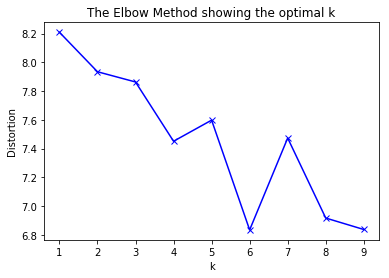

In [85]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# scale the data and make clusterization
se = StandardScaler()


X = se.fit_transform(brooklyn_property_sales_cluster)

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X)
    kmeanModel.fit(X)
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [88]:
# let's stick with 5 clusters

kclusters = 5

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(X)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

In [89]:
len(kmeans.labels_)

14797

In [90]:
brooklyn_property_sales['clusters'] = kmeans.labels_

In [91]:
brooklyn_property_sales['clusters'] = brooklyn_property_sales['clusters'].dropna().astype(int)

In [92]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(brooklyn_property_sales['lat'], brooklyn_property_sales['long'], brooklyn_property_sales['nbhd'], brooklyn_property_sales['clusters']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)

    
#add New York City College of Technology to the map (big dark circle)  
label = folium.Popup('New York City College of Technology', parse_html=True)
folium.CircleMarker(
        [40.695457, -73.9864678851903],
        radius=20,
        popup=label,
        color='dark green',
        fill=True,
        fill_color='dark green',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters)    
       
map_clusters

# Analyzing the clusters

In [93]:
brooklyn_property_sales['clusters'].value_counts()

0    7297
4    5346
1    2083
2      62
3       9
Name: clusters, dtype: int64

### Cluster 0

In [94]:
brooklyn_property_sales[brooklyn_property_sales['clusters'] == 0][:10]

,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9,clusters
6499,3,BATH BEACH,8674 17TH AVENUE,11214,40.607297,-74.006220,2,2432,1250000,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6504,3,BATH BEACH,15 BAY 23RD STREET,11214,40.604558,-73.999499,2,2417,1330000,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6505,3,BATH BEACH,8672 21ST AVENUE,11214,40.602010,-73.997389,2,2433,1380000,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6507,3,BATH BEACH,45 BAY 28TH STREET,11214,40.601928,-73.996237,2,5800,5040000,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6509,3,BATH BEACH,

### Cluster 1

In [95]:
brooklyn_property_sales[brooklyn_property_sales['clusters'] == 1][:10]

,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9,clusters
6291,3,BATH BEACH,8647 15TH AVENUE,11228,40.610414,-74.010528,1,1547,758000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
6292,3,BATH BEACH,55 BAY 10TH STREET,11228,40.609857,-74.009897,1,1933,778000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
6294,3,BATH BEACH,1906 86TH STREET,11214,40.605798,-74.000248,1,1900,1365000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
6295,3,BATH BEACH,50 BAY 23RD STREET,11214,40.604094,-74.000011,1,2417,750000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
6296,3,BATH BEACH,196

### Cluster 2

In [96]:
brooklyn_property_sales[brooklyn_property_sales['clusters'] == 2][:10]

,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9,clusters
6557,3,BATH BEACH,1934 BATH AVENUE,11214,40.602093,-74.002769,2,2160,1200000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
7457,3,BAY RIDGE,8617 4 AVENUE,11209,40.622327,-74.028533,2,1720,108000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
7458,3,BAY RIDGE,8615 4 AVENUE,11209,40.622373,-74.028515,2,1859,108000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
8916,3,BEDFORD STUYVESANT,912 GATES AVENUE,11221,40.688822,-73.927879,2,1580,1100000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
8925,3,BEDFORD STUYVESAN

### Cluster 3

In [97]:
brooklyn_property_sales[brooklyn_property_sales['clusters'] == 3][:10]

,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9,clusters
9045,3,BEDFORD STUYVESANT,186 FRANKLIN AVENUE,11205,40.693121,-73.957758,2,0,5000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
9046,3,BEDFORD STUYVESANT,452 LAFAYETTE AVENUE,11205,40.689237,-73.956852,2,0,325840,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
10135,3,BOERUM HILL,438 ATLANTIC AVENUE,11217,40.686494,-73.983727,2,0,3250000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
11169,3,BOROUGH PARK,1441 54TH STREET,11219,40.630323,-73.991858,2,0,566637,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
11172,3,

### Cluster 4

In [98]:
brooklyn_property_sales[brooklyn_property_sales['clusters'] == 4][:10]

,borough,nbhd,address,zip,lat,long,tax_cls_s,land_sqft,price,CAT__01 ONE FAMILY DWELLINGS,CAT__02 TWO FAMILY DWELLINGS,CAT__03 THREE FAMILY DWELLINGS,CAT__04 TAX CLASS 1 CONDOS,CAT__05 TAX CLASS 1 VACANT LAND,CAT__06 TAX CLASS 1 - OTHER,CAT__07 RENTALS - WALKUP APARTMENTS,CAT__08 RENTALS - ELEVATOR APARTMENTS,CAT__09 COOPS - WALKUP APARTMENTS,CAT__10 COOPS - ELEVATOR APARTMENTS,CAT__11 SPECIAL CONDO BILLING LOTS,CAT__11A CONDO-RENTALS,CAT__12 CONDOS - WALKUP APARTMENTS,CAT__13 CONDOS - ELEVATOR APARTMENTS,CAT__14 RENTALS - 4-10 UNIT,CAT__15 CONDOS - 2-10 UNIT RESIDENTIAL,CAT__16 CONDOS - 2-10 UNIT WITH COMMERCIAL UNIT,CAT__17 CONDO COOPS,CAT__18 TAX CLASS 3 - UNTILITY PROPERTIES,CAT__21 OFFICE BUILDINGS,CAT__22 STORE BUILDINGS,CAT__23 LOFT BUILDINGS,CAT__27 FACTORIES,CAT__28 COMMERCIAL CONDOS,CAT__29 COMMERCIAL GARAGES,CAT__30 WAREHOUSES,CAT__31 COMMERCIAL VACANT LAND,CAT__32 HOSPITAL AND HEALTH FACILITIES,CAT__33 EDUCATIONAL FACILITIES,CAT__35 INDOOR PUBLIC AND CULTURAL FACILITIES,CAT__36 OUTDOOR RECREATIONAL FACILITIES,CAT__37 RELIGIOUS FACILITIES,CAT__38 ASYLUMS AND HOMES,CAT__39 TRANSPORTATION FACILITIES,CAT__41 TAX CLASS 4 - OTHER,CAT__42 CONDO CULTURAL/MEDICAL/EDUCATIONAL/ETC,CAT__43 CONDO OFFICE BUILDINGS,CAT__44 CONDO PARKING,CAT__46 CONDO STORE BUILDINGS,CAT__47 CONDO NON-BUSINESS STORAGE,CAT__48 CONDO TERRACES/GARDENS/CABANAS,CAT__49 CONDO WAREHOUSES/FACTORY/INDUS,CAT__A1,CAT__A2,CAT__A3,CAT__A4,CAT__A5,CAT__A9,CAT__B1,CAT__B2,CAT__B3,CAT__B9,CAT__C0,CAT__C1,CAT__C2,CAT__C3,CAT__C4,CAT__C5,CAT__C6,CAT__C7,CAT__C8,CAT__C9,CAT__D0,CAT__D1,CAT__D3,CAT__D4,CAT__D5,CAT__D6,CAT__D7,CAT__D8,CAT__D9,CAT__E1,CAT__E2,CAT__E3,CAT__E7,CAT__E9,CAT__F1,CAT__F2,CAT__F4,CAT__F5,CAT__F8,CAT__F9,CAT__G0,CAT__G1,CAT__G2,CAT__G3,CAT__G4,CAT__G5,CAT__G6,CAT__G7,CAT__G8,CAT__G9,CAT__GU,CAT__I1,CAT__I4,CAT__I5,CAT__I6,CAT__I7,CAT__I9,CAT__K1,CAT__K2,CAT__K4,CAT__K5,CAT__K9,CAT__L9,CAT__M1,CAT__M2,CAT__M3,CAT__M4,CAT__M9,CAT__N2,CAT__N9,CAT__O1,CAT__O2,CAT__O5,CAT__O6,CAT__O7,CAT__O8,CAT__O9,CAT__P3,CAT__P5,CAT__P6,CAT__Q9,CAT__R0,CAT__R1,CAT__R2,CAT__R3,CAT__R4,CAT__R5,CAT__R6,CAT__R8,CAT__R9,CAT__RA,CAT__RB,CAT__RG,CAT__RK,CAT__RP,CAT__RR,CAT__RS,CAT__RT,CAT__RW,CAT__S0,CAT__S1,CAT__S2,CAT__S3,CAT__S4,CAT__S5,CAT__S9,CAT__T9,CAT__U7,CAT__V0,CAT__V1,CAT__V2,CAT__V3,CAT__V9,CAT__W1,CAT__W2,CAT__W3,CAT__W8,CAT__W9,CAT__Z0,CAT__Z9,clusters
6322,3,BATH BEACH,8661 14TH AVENUE,11228,40.611605,-74.012876,1,2320,980000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
6323,3,BATH BEACH,70 BAY 7TH STREET,11228,40.611048,-74.012271,1,2320,750000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
6324,3,BATH BEACH,37 BAY 7 STREET,11228,40.611504,-74.011770,1,2320,970000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
6325,3,BATH BEACH,35 BAY 7TH ST,11228,40.611531,-74.011741,1,2320,855000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
6326,3,BATH BEACH,35 BAY 7TH 

***Having analyzed the clusters by value counts of the category values, here's my interptretation of each of them:***

cluster 0, COOPS - ELEVATOR APARTMENTS, CONDOS - ELEVATOR APARTMENTS and RENTALS - WALKUP APARTMENTS with price between 550,000 USD and 1,200,000 USD. The most populous cluster

cluster 1, ONE FAMILY DWELLINGS, with price varying between 450,000 USD and 800,000 USD on average

cluster 2, RENTALS, with price varying between 150,000 USD and 500,000 USD on average

cluster 3, CONDOS, with varying price, just several instances

cluster 4, ONE FAMILY DWELLINGS to THREE FAMILY DWELLINGS, with price between roughly 650,000 USD and 1,200,000 USD



---

Also, let's get the cluster distribution from the brooklyn neighborhoods and pivot it to get the list of unique neighborhoods. Then, we'll merge these data with brooklyn_data file containing the coordinates and neighborhood names. 

In [101]:
brooklyn_property_pivot = brooklyn_property_sales.pivot_table(index = 'nbhd', columns = 'clusters', values = 'zip', aggfunc = 'count')
brooklyn_property_pivot.index = brooklyn_property_pivot.index.str.title()
brooklyn_property_pivot.head()

clusters,0,1,2,3,4
nbhd,,,,,
Bath Beach,55.0,20.0,1.0,NaN,110.0
Bay Ridge,375.0,134.0,2.0,NaN,163.0
Bedford Stuyvesant,431.0,44.0,3.0,2.0,527.0
Bensonhurst,57.0,42.0,NaN,NaN,158.0
Bergen Beach,16.0,42.0,NaN,NaN,66.0


In [102]:
# merge with brooklyn_data. Since the number of nbhds is slighly lower on the propertt sales data, the inner join will cut some of them in the resultsing df.

brooklyn_data_merged = brooklyn_data.merge(brooklyn_property_pivot, left_on = 'Neighborhood', right_on = 'nbhd')
cols = ['Borough', 'Neighborhood', 'Latitude', 'Longitude', 'sc_0', 'sc_1', 'sc_2', 'sc_3', 'sc_4']
brooklyn_data_merged.columns = cols
brooklyn_data_merged.head()


,Borough,Neighborhood,Latitude,Longitude,sc_0,sc_1,sc_2,sc_3,sc_4
0,Brooklyn,Bay Ridge,40.625801,-74.030621,375.0,134.0,2.0,NaN,163.0
1,Brooklyn,Bensonhurst,40.611009,-73.995180,57.0,42.0,NaN,NaN,158.0
2,Brooklyn,Sunset Park,40.645103,-74.010316,186.0,17.0,NaN,NaN,177.0
3,Brooklyn,Greenpoint,40.730201,-73.954241,192.0,10.0,7.0,NaN,64.0
4,Brooklyn,Gravesend,40.595260,-73.973471,132.0,74.0,1.0,NaN,179.0


- Having clustered Brooklyn on real estate data and cluster distribution by neighborhood, we see that our starting point, New York City College of Technology, is located in in cluster 0. 
- This corresponds to mid to high range price of real estate sales. Just what's needed!

# Foursquare database

In [42]:
CLIENT_ID = '0YIQ24X3FLRLP5YU5ZESMLU3DVMBGIB2P0PLA20E0B1MBYFC' # your Foursquare ID
CLIENT_SECRET = 'EYHP3PPZE5MT4OTPQ3A32W4SHDGXHLMCFMO5X2M3FMZTRIAT' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 0YIQ24X3FLRLP5YU5ZESMLU3DVMBGIB2P0PLA20E0B1MBYFC
CLIENT_SECRET:EYHP3PPZE5MT4OTPQ3A32W4SHDGXHLMCFMO5X2M3FMZTRIAT


In [51]:
def getNearbyVenues(latitudes, longitudes, radius=2000, LIMIT = 300):
    
    venues_list=[]    
       
    # create the API request URL - restaurants
    category = '4d4b7105d754a06374d81259'


    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        neighborhood_latitude, 
        neighborhood_longitude,
        category,
    
        radius, 
        LIMIT)
      
      # make the GET request
    results = requests.get(url).json()["response"]['groups'][0]['items']
      
      # return only relevant information for each nearby venue
    venues_list.append([(
            v['venue']['id'], 
            v['venue']['name'],
            v['venue']['categories'][0]['name'],
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],
            v['venue']['location']['distance']          
            ) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = [ 
                  'ID',
                  'Venue', 
                  'Venue Category',
                  'Venue Latitude', 
                  'Venue Longitude',
                  'Distance from the NYC College of Technology',
                  ]
    
    return(nearby_venues)

In [52]:
# coordinates of the NYC College of Technology 

neighborhood_latitude = 40.695457
neighborhood_longitude =  -73.9864678851903

nb = getNearbyVenues(neighborhood_latitude, neighborhood_longitude)
nb.set_index('ID')

,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology
ID,,,,,
594277b586f4cc0f251fc389,DeKalb Market Hall,Food Court,40.691250,-73.982579,571
59da9590e1f0aa52976b8f35,Han Dynasty,Chinese Restaurant,40.691334,-73.982456,570
5a87210eda5ede7ae86f82c6,Korilla BBQ,Asian Restaurant,40.693803,-73.985843,191
53d1a481498e1fac7c37f675,Pollo d'Oro,Peruvian Restaurant,40.694823,-73.983373,270
59a3040fda708024d6926771,Brooklyn Bridge Bistro And Winebar,Bistro,40.696272,-73.988343,182
4b6b6ad0f964a52066072ce3,Sushi Gallery,Sushi Restaurant,40.697595,-73.993236,618
53b36289498e528b6cad6624,Forno Rosso,Pizza Place,40.694437,-73.983442,279
5946d138e2da1964625ca9b2,Daigo Hand Roll Bar,Japanese Restaurant,40.691259,-73.982603,569
594416bca4ba7c683f5492df,A Taste Of Katz's,Sandwich Place,40.691378,-73.982426,567


In [53]:
nb.shape

(100, 6)

In [54]:
nb.groupby('Venue Category')['Venue'].count().sort_values(ascending = False)

Venue Category
Bakery                           8
American Restaurant              7
Pizza Place                      7
Italian Restaurant               7
Bagel Shop                       6
Japanese Restaurant              6
French Restaurant                5
Thai Restaurant                  3
Burger Joint                     3
Middle Eastern Restaurant        3
Sandwich Place                   3
Deli / Bodega                    3
New American Restaurant          2
Mediterranean Restaurant         2
Café                             2
Seafood Restaurant               2
Sushi Restaurant                 2
Chinese Restaurant               2
Asian Restaurant                 2
Restaurant                       2
Diner                            1
Burrito Place                    1
Cajun / Creole Restaurant        1
Bistro                           1
Caribbean Restaurant             1
Creperie                         1
Cuban Restaurant                 1
Vegetarian / Vegan Restaurant    1
Dumpl

Now, let's get more details about these places, including the rating and the price tier

In [55]:
details = []

for i in nb.ID:
    url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}&'.format(
        i,
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION 
        )
    results = requests.get(url).json()
    
    try:
        details.append([
                    results['response']['venue']['id'] if results['response']['venue']['id'] else 0,
                    results['response']['venue']['stats']['tipCount'] if results['response']['venue']['stats']['tipCount'] else 0,
                    results['response']['venue']['price']['tier'] if results['response']['venue']['price'] else 0,
                    results['response']['venue']['likes']['count'] if results['response']['venue']['likes']['count'] else 0,
                    results['response']['venue']['rating'] if results['response']['venue']['rating'] else 0 ])
    except KeyError:
        continue

    
    

In [56]:
nearby_venues = pd.DataFrame(details)
nearby_venues.columns = [ 
                  'ID',
                  'Tips_count', 
                  'Price tier', 
                  'Likes_count',
                  'Rating',
                  ]
nearby_venues.set_index('ID')

,Tips_count,Price tier,Likes_count,Rating
ID,,,,
594277b586f4cc0f251fc389,96,2,731,9.3
59da9590e1f0aa52976b8f35,30,1,145,8.8
5a87210eda5ede7ae86f82c6,4,2,24,8.0
53d1a481498e1fac7c37f675,15,2,37,8.1
4b6b6ad0f964a52066072ce3,15,2,38,8.8
53b36289498e528b6cad6624,39,1,165,8.1
5946d138e2da1964625ca9b2,10,2,46,8.6
594416bca4ba7c683f5492df,3,1,36,8.5
479ccb47f964a5206b4d1fe3,66,2,140,8.4


#### Price tier

From the foursquare description, currently the valid range of price points are [1,2,3,4], 1 being the least expensive, 4 being the most expensive. For food venues, in the United States, 1 is < 10 USD an entree, 2 is 10-20 USD an entree, 3 is 20-30USD an entree, 4 is > 30 USD an entree

In [57]:
nb_merged = nb.merge(nearby_venues, right_index = True, left_index = True).drop('ID_y',axis = 1)
nb_merged

,ID_x,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology,Tips_count,Price tier,Likes_count,Rating
0,594277b586f4cc0f251fc389,DeKalb Market Hall,Food Court,40.691250,-73.982579,571,96,2,731,9.3
1,59da9590e1f0aa52976b8f35,Han Dynasty,Chinese Restaurant,40.691334,-73.982456,570,30,1,145,8.8
2,5a87210eda5ede7ae86f82c6,Korilla BBQ,Asian Restaurant,40.693803,-73.985843,191,4,2,24,8.0
3,53d1a481498e1fac7c37f675,Pollo d'Oro,Peruvian Restaurant,40.694823,-73.983373,270,15,2,37,8.1
4,59a3040fda708024d6926771,Brooklyn Bridge Bistro And Winebar,Bistro,40.696272,-73.988343,182,15,2,38,8.8
5,4b6b6ad0f964a52066072ce3,Sushi Gallery,Sushi Restaurant,40.697595,-73.993236,618,39,1,165,8.1
6,53b36289498e528b6cad6624,Forno Rosso,Pizza Place,40.694437,-73.983442,279,10,2,46,8.6
7,5946d138e2da1964625ca9b2,Daigo Hand Roll Bar,Japanese Restaurant,40.691259,-73.982603,569,3,1,36,8.5
8,594416bca4ba7c683f5492df,A Taste Of Katz's,Sandwich Place,40.691378,-73.982426,567,66,2,140,8.4
9,479ccb47f964a5206b4d1fe3,Iron Chef House,Japanese Restaurant,40.697406,-73.992560,558,32,1,140,9.2


Let's add these places to the brooklyn map and clusterize them thereafter.

In [58]:
address = 'Brooklyn, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Brooklyn are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Brooklyn are 40.6501038, -73.9495823.


In [59]:
# create map of Brooklyn using latitude and longitude values
map_brooklyn_1 = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(nb['Venue Latitude'], nb['Venue Longitude'], nb['Venue']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_brooklyn_1)  


#add New York City College of Technology to the map
label = folium.Popup('New York City College of Technology', parse_html=True)
folium.CircleMarker(
        [40.695457, -73.9864678851903],
        radius=20,
        popup=label,
        color='dark green',
        fill=True,
        fill_color='dark green',
        fill_opacity=0.7,
        parse_html=False).add_to(map_brooklyn_1)     
    
map_brooklyn_1

Okay, that's a good sign since most of the venues are on the opposite side of the river. Let's clusterize them.



/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


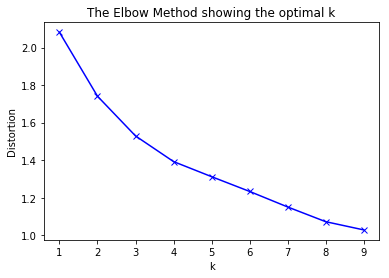

In [60]:
venues_cluster = nb_merged.iloc[:,5:]


se = StandardScaler()


X_1 = se.fit_transform(venues_cluster)

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X_1)
    kmeanModel.fit(X_1)
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [61]:
# let's stick with 3 clusters

kclusters = 3

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(X)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [62]:
pd.Series(kmeans.labels_).value_counts()

0    37
1    32
2    28
dtype: int64

In [63]:
nb_merged['cluster'] = kmeans.labels_
nb_merged.head()

,ID_x,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology,Tips_count,Price tier,Likes_count,Rating,cluster
0,594277b586f4cc0f251fc389,DeKalb Market Hall,Food Court,40.691250,-73.982579,571,96,2,731,9.3,2
1,59da9590e1f0aa52976b8f35,Han Dynasty,Chinese Restaurant,40.691334,-73.982456,570,30,1,145,8.8,0
2,5a87210eda5ede7ae86f82c6,Korilla BBQ,Asian Restaurant,40.693803,-73.985843,191,4,2,24,8.0,0
3,53d1a481498e1fac7c37f675,Pollo d'Oro,Peruvian Restaurant,40.694823,-73.983373,270,15,2,37,8.1,0
4,59a3040fda708024d6926771,Brooklyn Bridge Bistro And Winebar,Bistro,40.696272,-73.988343,182,15,2,38,8.8,0


Add clesters labels to the map

In [105]:
# create map
map_clusters_1 = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cat, cluster in zip(nb_merged['Venue Latitude'], nb_merged['Venue Longitude'], nb_merged['Venue'], nb_merged['Venue Category'] ,  nb_merged['cluster']):
    label = folium.Popup(str(poi) + "_" + str(cat) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters_1)

#add New York City College of Technology to the map   
label = folium.Popup('New York City College of Technology', parse_html=True)
folium.CircleMarker(
        [40.695457, -73.9864678851903],
        radius=20,
        popup=label,
        color='dark green',
        fill=True,
        fill_color='dark green',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters_1)    
map_clusters_1

# Quick analysis of the venues clusters

## Cluster 0

In [65]:
nb_merged[nb_merged['cluster']  == 0]

,ID_x,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology,Tips_count,Price tier,Likes_count,Rating,cluster
1,59da9590e1f0aa52976b8f35,Han Dynasty,Chinese Restaurant,40.691334,-73.982456,570,30,1,145,8.8,0
2,5a87210eda5ede7ae86f82c6,Korilla BBQ,Asian Restaurant,40.693803,-73.985843,191,4,2,24,8.0,0
3,53d1a481498e1fac7c37f675,Pollo d'Oro,Peruvian Restaurant,40.694823,-73.983373,270,15,2,37,8.1,0
4,59a3040fda708024d6926771,Brooklyn Bridge Bistro And Winebar,Bistro,40.696272,-73.988343,182,15,2,38,8.8,0
5,4b6b6ad0f964a52066072ce3,Sushi Gallery,Sushi Restaurant,40.697595,-73.993236,618,39,1,165,8.1,0
6,53b36289498e528b6cad6624,Forno Rosso,Pizza Place,40.694437,-73.983442,279,10,2,46,8.6,0
7,5946d138e2da1964625ca9b2,Daigo Hand Roll Bar,Japanese Restaurant,40.691259,-73.982603,569,3,1,36,8.5,0
8,594416bca4ba7c683f5492df,A Taste Of Katz's,Sandwich Place,40.691378,-73.982426,567,66,2,140,8.4,0
9,479ccb47f964a5206b4d1fe3,Iron Chef House,Japanese Restaurant,40.697406,-73.992560,558,32,1,140,9.2,0
10,5949c93c3ba767778ec8fad9,Eight Turn Crêpe,Creperie,40.691186,-73.982831,565,2,2,13,8.1,0


In [69]:
nb_merged[nb_merged['cluster']  == 0].groupby('Venue Category')['Venue'].count().sort_values(ascending = False)

Venue Category
Bakery                       5
Japanese Restaurant          3
Thai Restaurant              2
New American Restaurant      2
Bagel Shop                   2
Chinese Restaurant           2
French Restaurant            2
Italian Restaurant           2
Middle Eastern Restaurant    1
Sandwich Place               1
South American Restaurant    1
Seafood Restaurant           1
Bistro                       1
Burger Joint                 1
Café                         1
Caribbean Restaurant         1
Creperie                     1
Mediterranean Restaurant     1
Diner                        1
Falafel Restaurant           1
Pizza Place                  1
Sushi Restaurant             1
Peruvian Restaurant          1
Latin American Restaurant    1
Asian Restaurant             1
Name: Venue, dtype: int64

## Cluster 1

In [66]:
nb_merged[nb_merged['cluster']  == 1]

,ID_x,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology,Tips_count,Price tier,Likes_count,Rating,cluster
20,5012043564a4944f5c47738a,Dellarocco's,Pizza Place,40.694992,-73.995924,799,38,1,114,7.8,1
28,51b0ceff2d4e2ee801fd4ab2,Foragers,Deli / Bodega,40.702468,-73.988569,800,48,1,100,8.4,1
30,4a635ce2f964a520dbc41fe3,Lassen & Hennigs,Deli / Bodega,40.694970,-73.994857,710,9,1,31,8.1,1
35,4cbf097828d176b0a7c6226e,Colonie,American Restaurant,40.690733,-73.995963,958,60,2,195,8.7,1
36,49e63b62f964a52027641fe3,Ki Sushi,Sushi Restaurant,40.687574,-73.989936,925,92,2,211,8.1,1
40,4f3265a119836c91c7d3c6f7,Hadramout Restaurant,Restaurant,40.689818,-73.993877,886,6,2,15,8.0,1
43,50ca6337e4b04e1f3135689c,Juliana's Pizza,Pizza Place,40.702769,-73.993616,1013,9,1,23,8.7,1
46,48a41073f964a52091511fe3,Hibino,Japanese Restaurant,40.690076,-73.996497,1037,22,1,73,7.7,1
49,4be30f9dd27a20a1cd1f915b,River Deli,Italian Restaurant,40.693713,-73.998435,1028,122,1,343,8.7,1
51,43164480f964a52065271fe3,Bedouin Tent,Middle Eastern Restaurant,40.686936,-73.984469,963,4,2,18,8.0,1


In [70]:
nb_merged[nb_merged['cluster']  == 1].groupby('Venue Category')['Venue'].count().sort_values(ascending = False)

Venue Category
American Restaurant          4
Deli / Bodega                3
Italian Restaurant           3
Bakery                       2
Pizza Place                  2
Japanese Restaurant          2
French Restaurant            2
Spanish Restaurant           1
Gastropub                    1
Burger Joint                 1
Sushi Restaurant             1
Dumpling Restaurant          1
Food Truck                   1
German Restaurant            1
Seafood Restaurant           1
Israeli Restaurant           1
Taco Place                   1
Mediterranean Restaurant     1
Middle Eastern Restaurant    1
Restaurant                   1
Thai Restaurant              1
Name: Venue, dtype: int64

## Cluster 2

In [67]:
nb_merged[nb_merged['cluster']  == 2]

,ID_x,Venue,Venue Category,Venue Latitude,Venue Longitude,Distance from the NYC College of Technology,Tips_count,Price tier,Likes_count,Rating,cluster
0,594277b586f4cc0f251fc389,DeKalb Market Hall,Food Court,40.691250,-73.982579,571,96,2,731,9.3,2
16,50478b43e4b05a8c89d8198c,Sophies Cuban Cuisine,Cuban Restaurant,40.690602,-73.987700,550,80,3,420,9.0,2
17,583c7fa58cfe547612b47b93,Westville DUMBO,American Restaurant,40.702021,-73.989596,776,114,2,416,9.0,2
19,4e793558aeb79f7dab5c7f6f,Sottocasa Pizzeria,Pizza Place,40.688534,-73.988947,798,121,3,306,9.2,2
21,4dc5a9c8e4cd169dc6532c66,Shelsky's of Brooklyn,Bagel Shop,40.689486,-73.992518,838,112,3,550,9.0,2
25,550c4a17498e1d6612e9dffc,Bread & Spread,Sandwich Place,40.702541,-73.987082,790,95,2,333,9.0,2
29,5942d5c94c9be62191b036fa,sweetgreen,Salad Place,40.702914,-73.989830,877,254,3,691,9.1,2
31,49d3773df964a520fb5b1fe3,Vinegar Hill House,American Restaurant,40.702686,-73.981260,916,310,2,737,8.8,2
33,4b5e4c9df964a520648829e3,Mile End Delicatessen,Sandwich Place,40.687549,-73.987018,881,233,3,732,9.2,2
34,4a748cd9f964a52092de1fe3,Fast and Fresh Burrito Deli,Burrito Place,40.687983,-73.986935,832,88,3,193,8.9,2


In [71]:
nb_merged[nb_merged['cluster']  == 2].groupby('Venue Category')['Venue'].count().sort_values(ascending = False)

Venue Category
American Restaurant              3
Bagel Shop                       3
Pizza Place                      3
Italian Restaurant               2
Sandwich Place                   2
Cajun / Creole Restaurant        1
Asian Restaurant                 1
Bakery                           1
Burger Joint                     1
Burrito Place                    1
Café                             1
Vegetarian / Vegan Restaurant    1
Cuban Restaurant                 1
French Restaurant                1
Japanese Restaurant              1
Kebab Restaurant                 1
Mexican Restaurant               1
Restaurant                       1
Salad Place                      1
Food Court                       1
Name: Venue, dtype: int64

In [116]:
nb_merged[(nb_merged['cluster']  == 0) | nb_merged['cluster']  == 1 ][['Venue', 'Venue Category',
                                        'Distance from the NYC College of Technology',
                                        'Tips_count',
                                        'Price tier', 
                                        'Rating' ] ].nlargest(20, columns = 'Rating').reset_index(drop = True)

,Venue,Venue Category,Distance from the NYC College of Technology,Tips_count,Price tier,Rating
0,DeKalb Market Hall,Food Court,571,96,2,9.3
1,Charm Kao,Thai Restaurant,669,19,1,9.3
2,Cecconi's,Italian Restaurant,1034,227,3,9.3
3,Arepa Lady,South American Restaurant,568,44,2,9.3
4,Iron Chef House,Japanese Restaurant,558,32,1,9.2
5,Sottocasa Pizzeria,Pizza Place,798,121,3,9.2
6,Mile End Delicatessen,Sandwich Place,881,233,3,9.2
7,Bien Cuit,Bakery,916,7,2,9.2
8,One Girl Cookies,Bakery,952,152,2,9.2
9,Yemen Cafe,Middle Eastern Restaurant,851,12,1,9.1


From the analysis above we can conclude that:
- cluster 0 - cheap and mid range venues with low to moderate tips count and high middle rating, close vicinity (till 800-900 m), mostly Bakery and Asian venues
- cluster 1 - cheap to mid range venues with moderate tips count, moderate likes count, and middle rating, middle distance (800-1300 m) mostly American and European restaurants
- cluster 2 - expensive venues with middle to huge tips count, likes count, and high rating, middle distance(700-1000 m), mostly American and European restaurants

Since our restaurant is going to be vegetarian and middle range income, our direct competitors would be mostly cluster 0 venues and possibly cluster 1, even if they're further located. There's even one direct competitor, another vegie venue - Wild Ginger, in cluster 2, located about 900 m from the college. But it's a more expensive venue, which can be of advantage to us.

## Metro stations

Let's look for the nearby metro stations around the college

In [73]:
ny_metro_stations = pd.read_csv('ny_data/ny_metro_stations.csv')[['stop_name','complex_id','stop_lat','stop_lon' ]].dropna()

brooklyn_metro_stations = ny_metro_stations[ny_metro_stations['complex_id'].str.startswith('bk')]
brooklyn_metro_stations.head()

,stop_name,complex_id,stop_lat,stop_lon
65,Clark St,bk061,40.697466,-73.993086
66,Borough Hall,bk068,40.693219,-73.989998
67,Hoyt St,bk097,40.690545,-73.985065
68,Nevins St,bk123,40.688246,-73.980492
69,Atlantic Av - Barclays Ctr,bk026,40.684359,-73.977666


In [121]:
# add markers to map
for lat, lng, label in zip(brooklyn_metro_stations['stop_lat'], brooklyn_metro_stations['stop_lon'], brooklyn_metro_stations['stop_name']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=10,
        popup=label,
        color='grey',
        fill=True,
        fill_color='grey',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters_1)    
        
map_clusters_1

Excellent! In the vicinity we have three metro stations: Court St., Borough hall, and Jay St MetroTech. 

## University locations

Now, let's get the data of the New York universities to identify if the chosen starting point is actually part of the educational conglomerate

In [76]:
ny_uni = pd.read_csv('ny_data/nyu_uni.csv')
ny_uni.head()

,X,Y,id,name,address,zip,factype,facname,capacity,capname,bcode,xcoord,ycoord
0,1039079,234351,12000000001304,MARITIME COLLEGE AT FORT SCHUYLER (SUNY),6 Pennyfield Ave,10465,1201,SUNY - The State University of New York,1799.0,Enrollment,36005,1039079.0,234351.0
1,999458,177948,12000000000085,HEALTH SCIENCE CENTER AT BROOKLYN (SUNY),450 Clarkson Ave,11203,1201,SUNY - The State University of New York,1865.0,Enrollment,36047,999458.0,177948.0
2,985698,211585,12000000000022,FASHION INSTITUTE OF TECHNOLOGY (SUNY),227 W 27 St,10001,1201,SUNY - The State University of New York,9764.0,Enrollment,36061,985698.0,211585.0
3,989188,214157,12000000000023,NYS COLLEGE OF OPTOMETRY (SUNY),33 W 42 St,10036,1201,SUNY - The State University of New York,363.0,Enrollment,36061,989188.0,214157.0
4,1009244,251859,12000000001458,BRONX COMMUNITY COLLEGE (CUNY),2155 University Ave,10453,1202,CUNY - The City University of New York,11506.0,Enrollment,36005,1009244.0,251859.0


In [77]:
def get_location(address):
    address = address + ', New York'
    try:
        geolocator = Nominatim(user_agent="ny_explorer")
        location = geolocator.geocode(address)
        latitude = location.latitude
        longitude = location.longitude
        results = pd.DataFrame([address,latitude,longitude])
        return latitude, longitude
    except:
        pass

In [78]:
get_uni_location = ny_uni.address.apply(get_location)

In [79]:
ny_uni['latitude'] = [i[0] if i is not None else None for i in get_uni_location]
ny_uni['longitude'] = [i[1] if i is not None else None for i in get_uni_location]

ny_uni = ny_uni.dropna()[['name', 'latitude','longitude']]

In [122]:
# add unive to map
for lat, lng, label in zip(ny_uni['latitude'], ny_uni['longitude'], ny_uni['name']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=10,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='yellow',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters_1) 
    
map_clusters_1

# Results and Discussion

The purpose of this project has been to investigate and segment the neighbourhoods in Brooklyn. In specific, with respect to opening the vegetarian restaurant in vicinity of NYC College of Technology. The starting point has been taken with respect to proximity to the metro stations, high number of young people who are more likely to consume organic / vegetarian food. The requirement was to open the spot in middle range income area. For this purpose I analyzed a more macro indicator of real estate sales, revealing that our terriroty indeed is a mid income range one. The analysis presented that most of the nearby buildings where flats were sold, belong to the cluster 0, which corresponds to the COOPS - ELEVATOR APARTMENTS, CONDOS - ELEVATOR APARTMENTS and RENTALS - WALKUP APARTMENTS with price between 550,000 USD and 1,200,000 USD. This is the most populous cluster. 


Second, i segmented the restaurant venues in proximity of 2 km, in order to reach the optimal distribution / number of places. It turned out that most of the direct competitors would be American and European restaurants plus Pizza places, mid range restaurants. Since our restaurant is going to be vegetarian and middle range income, our direct competitors would be mostly cluster 0 and 1 venues, even if they're further located. There's even one direct competitor, another vegie venue - Wild Ginger, in cluster 2, located about 900 m from the college. But it's a more expensive venue, which can be of advantage to us. 
The College of Technology indeed appeared to be a part of educational conglomerate as shown on the map, with 5 instituions presented in total, namely: NYC College of Technology, St Francis College,Brooklyn Law School, ASA College, and Institute of Design and Construction.

Therefore, I recommend to locate a new restaurant nearby Jay Street, Adams Street, Fulton Mall, Boroghby street, and Tillary Street. Also, an alternative could be on Remsen street, near the St Francis College. It's close to the subway station at Court St., and has no many competitors too close.

# Conclusion

In the end, the possible locations for a new vegetarian restaurant in Brooklyn are nearby Jay Street, Adams Street, Fulton Mall, Boroghby street, and Tillary Street. These streets present a good commute options, not far from the universities. Some other smaller streets in vicinity such as Chapel st. could be taken as well, however we must make sure it's not directly near the cathedral like there. 

The project has been quite a challenge, however i am glad i finished it. Hope that my findings at least present a healthy way of analysis and are a good starting point for a more indepth analysis to the potential investor who indeed would open a restaurant like this in Brooklyn. 

The project necesaarily had certain limitations which are related with the lack of the current data, for example, on the real estate sales. And in a commercial project some more thourough investigation would be necessary.